In [13]:
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import minimize
import matplotlib.pyplot as plt

# Define the 3-dimensional problem parameters
F_N = np.array([[2, 0, 0], [0, 1, 0], [0, 0, 1]])
F_B = np.array([[1, 0.5, 0.2], [0.5, 2, 0.3], [0.2, 0.3, 1]])
g_N = np.array([-2, -1, -1])
g_B = np.array([1, 1, 1])
epsilon = 0.01

# Solve the constrained optimization problem
def solve_constrained_problem(F_N, F_B, g_N, g_B, epsilon):
    x0=np.zeros_like(g_N)
    # Define the objective function
    def objective(x, F_N=F_N, g_N=g_N):
        return 0.5 * x.T @ F_N @ x + g_N.T @ x + 0.5 * x.T @ F_B @ x + g_B.T @ x
    
    # Define the constraint function
    def constraint(x, F_B=F_B, g_B=g_B, epsilon=epsilon):
        return 0.5 * x.T @ F_B @ x + g_B.T @ x - epsilon

    # Define the constraint dictionary for scipy.optimize.minimize
    cons = {'type': 'ineq', 'fun': lambda x: -constraint(x)}
    result_constrained = minimize(objective, x0, constraints=cons, method='SLSQP')
    return result_constrained.x
result_constrained = solve_constrained_problem(F_N, F_B, g_N, g_B, epsilon)

# Extract the constrained solution
x_opt_constrained = result_constrained
print(f"Constrained optimal solution: {x_opt_constrained}")

# Solve the unconstrained optimization problem
def solve_unconstrained_problem(F_N, g_N):
    x0=np.zeros_like(g_N)
    # Define the objective function
    def objective(x, F_N=F_N, g_N=g_N):
        return 0.5 * x.T @ F_N @ x + g_N.T @ x + 0.5 * x.T @ F_B @ x + g_B.T @ x
    
    result_unconstrained = minimize(objective, x0)
    return result_unconstrained.x
result_unconstrained = solve_unconstrained_problem(F_N, g_N)

# Extract the unconstrained solution
x_opt_unconstrained = result_unconstrained
print(f"Unconstrained optimal solution: {x_opt_unconstrained}")

# Solve the equation for the Lagrange multiplier
def compute_lambda(F_N, F_B, g_N, g_B, x_opt_constrained):
    u = np.ones_like(x_opt_constrained)
    denominator = u.T @ (F_B @ x_opt_constrained + g_B)
    numerator = u.T @ (F_N @ x_opt_constrained + g_N)
    return - numerator / denominator - 1

def check_lambda(F_N, F_B, g_N, g_B, x_opt_constrained, lmbda):
    x = - np.linalg.inv(F_N + (1+lmbda)*F_B) @ (g_N + (1+lmbda) * g_B)
    norm = np.linalg.norm(x - x_opt_constrained)
    return np.isclose(norm, 0, atol=0.1)
    

lmbda_opt = compute_lambda(F_N, F_B, g_N, g_B, x_opt_constrained)
print(f"Optimal Lagrange multiplier: {lmbda_opt}")
assert check_lambda(F_N, F_B, g_N, g_B, x_opt_constrained, lmbda_opt)


# Generate points for visualization
x_range = np.linspace(-3, 3, 50)
y_range = np.linspace(-3, 3, 50)
z_range = np.linspace(-3, 3, 50)
X, Y, Z = np.meshgrid(x_range, y_range, z_range)

# Compute objective function values
Z_obj = (0.5 * (F_N[0, 0] * X**2 + 2 * F_N[0, 1] * X * Y + 2 * F_N[0, 2] * X * Z +
                F_N[1, 1] * Y**2 + 2 * F_N[1, 2] * Y * Z + F_N[2, 2] * Z**2) + g_N[0] * X + g_N[1] * Y + g_N[2] * Z +
         0.5 * (F_B[0, 0] * X**2 + 2 * F_B[0, 1] * X * Y + 2 * F_B[0, 2] * X * Z +
                F_B[1, 1] * Y**2 + 2 * F_B[1, 2] * Y * Z + F_B[2, 2] * Z**2) + g_B[0] * X + g_B[1] * Y + g_B[2] * Z
)

# Compute constraint function values
Z_con = 0.5 * (F_B[0, 0] * X**2 + 2 * F_B[0, 1] * X * Y + 2 * F_B[0, 2] * X * Z +
               F_B[1, 1] * Y**2 + 2 * F_B[1, 2] * Y * Z + F_B[2, 2] * Z**2) + g_B[0] * X + g_B[1] * Y + g_B[2] * Z

# Create the 3D plot
fig = go.Figure()

# Add objective function contour
fig.add_trace(go.Isosurface(
    x=X.flatten(), y=Y.flatten(), z=Z.flatten(), value=Z_obj.flatten(),
    isomin=-20, isomax=20, surface_count=10, colorscale='Viridis', opacity=0.5,
    caps=dict(x_show=False, y_show=False)
))

# Add constraint surface
fig.add_trace(go.Isosurface(
    x=X.flatten(), y=Y.flatten(), z=Z.flatten(), value=Z_con.flatten(),
    isomin=epsilon, isomax=epsilon, surface_count=1, colorscale='Reds',
    opacity=0.6, caps=dict(x_show=False, y_show=False)
))

# Add the optimal constrained solution point
fig.add_trace(go.Scatter3d(
    x=[x_opt_constrained[0]], y=[x_opt_constrained[1]], z=[x_opt_constrained[2]], mode='markers',
    marker=dict(size=5, color='blue'), name='Constrained Optimal Solution'
))

# Add the optimal unconstrained solution point
fig.add_trace(go.Scatter3d(
    x=[x_opt_unconstrained[0]], y=[x_opt_unconstrained[1]], z=[x_opt_unconstrained[2]], mode='markers',
    marker=dict(size=5, color='red'), name='Unconstrained Optimal Solution'
))

# Set plot titles and labels
fig.update_layout(
    title='QCQP Problem in 3D',
    scene=dict(
        xaxis_title='x1',
        yaxis_title='x2',
        zaxis_title='x3'
    )
)

# Show plot
fig.show()


Constrained optimal solution: [ 0.23725315 -0.11651602 -0.14769739]
Unconstrained optimal solution: [ 0.344205   -0.05474665 -0.0262085 ]
Optimal Lagrange multiplier: 0.32714228997802075


## Emprirical Lambda Analysis



Sample: 0
Sample: 1


/tmp/ipykernel_43149/685307041.py:53: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



Sample: 2
Sample: 3
Sample: 4
Sample: 5
Sample: 6
Sample: 7
Sample: 8
Sample: 9
Sample: 10
Sample: 11
Sample: 12
Sample: 13
Sample: 14
Sample: 15
Sample: 16
Sample: 17
Sample: 18
Sample: 19
Sample: 20
Sample: 21
Sample: 22
Sample: 23
Sample: 24
Sample: 25
Sample: 26
Sample: 27
Sample: 28
Sample: 29
Sample: 30
Sample: 31
Sample: 32
Sample: 33
Sample: 34
Sample: 35
Sample: 36
Sample: 37
Sample: 38
Sample: 39
Sample: 40
Sample: 41
Sample: 42
Sample: 43
Sample: 44
Sample: 45
Sample: 46
Sample: 47
Sample: 48
Sample: 49
Sample: 50
Sample: 51
Sample: 52
Sample: 53
Sample: 54
Sample: 55
Sample: 56
Sample: 57
Sample: 58
Sample: 59
Sample: 60
Sample: 61
Sample: 62
Sample: 63
Sample: 64
Sample: 65
Sample: 66
Sample: 67
Sample: 68
Sample: 69
Sample: 70
Sample: 71
Sample: 72
Sample: 73
Sample: 74
Sample: 75
Sample: 76
Sample: 77
Sample: 78
Sample: 79
Sample: 80
Sample: 81
Sample: 82
Sample: 83
Sample: 84
Sample: 85
Sample: 86
Sample: 87
Sample: 88
Sample: 89
Sample: 90
Sample: 91
Sample: 92
Sample:

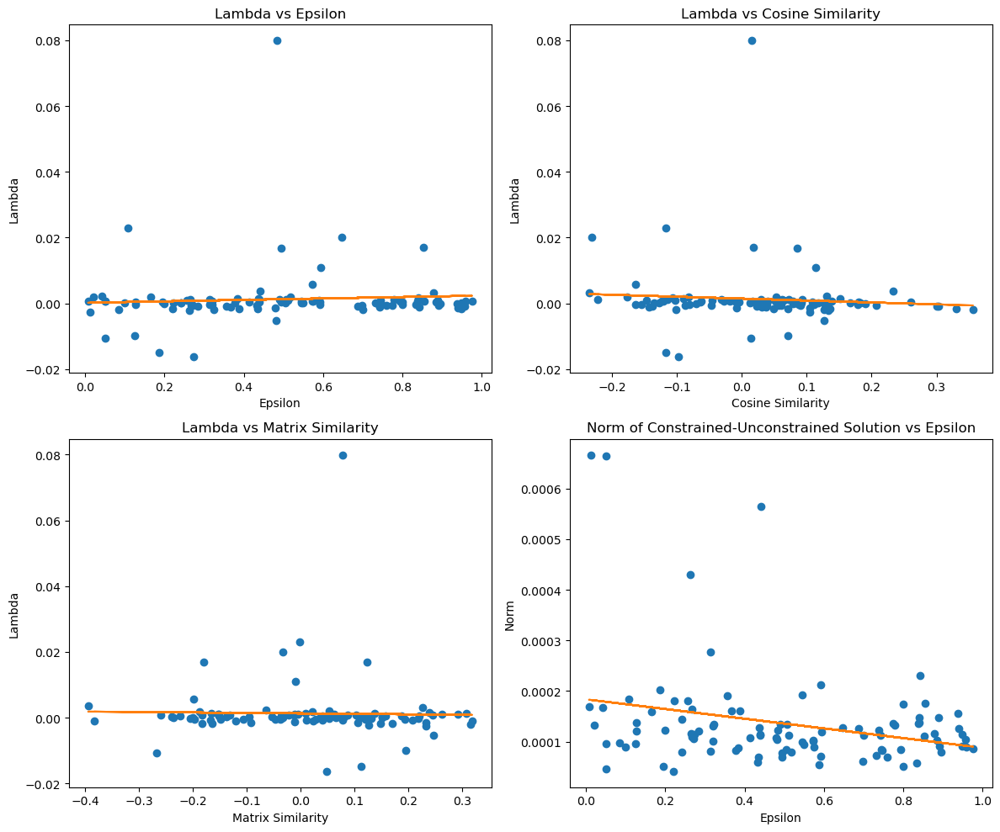

In [21]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize
from scipy.linalg import eigh
from scipy.stats import uniform
import plotly.graph_objects as go


# Function to generate positive definite matrices
def generate_positive_definite_matrix(dim):
    A = np.random.uniform(-2, 2, (dim, dim))  # Generate a random matrix with entries from -1 to 1
    return np.dot(A.T, A)  # Ensure the matrix is positive definite

# Function to compute cosine similarity
def cosine_similarity(a, b):
    return np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b))

def inv_matrix_similarity(F_N, F_B):
    _, V_N = eigh(np.linalg.inv(F_N))
    _, V_B = eigh(np.linalg.inv(F_B))
    ones = np.ones(F_N.shape[0])
    return cosine_similarity(V_N @ ones, V_B @ ones)
    

# Number of samples
num_samples = 100
n_dim = 50

# Dataframe to store results
results = pd.DataFrame(columns=['lambda', 'cosine_similarity', 'matrix_similarity', 'epsilon', 'cons_uncons_norm'])

# Generate random samples and compute results
for _ in range(num_samples):
    print(f"Sample: {_}")   
    F_N = generate_positive_definite_matrix(n_dim)
    F_B = generate_positive_definite_matrix(n_dim)
    g_N = np.random.uniform(-2, 2, n_dim)
    g_B = np.random.uniform(-2, 2, n_dim)
    epsilon = np.random.uniform(0, 1)

    x_opt_constrained = solve_constrained_problem(F_N, F_B, g_N, g_B, epsilon)
    x_opt_unconstrained = solve_unconstrained_problem(F_N, g_N)
    lmbda_opt = compute_lambda(F_N, F_B, g_N, g_B, x_opt_constrained)
    #Discard the results that do not pass the check
    if not check_lambda(F_N, F_B, g_N, g_B, x_opt_constrained, lmbda_opt):
        continue
    

    cons_uncons_norm = np.linalg.norm(x_opt_constrained - x_opt_unconstrained)
    cos_sim = cosine_similarity(g_N, g_B)
    matrix_sim = inv_matrix_similarity(F_N, F_B)

    results = pd.concat([results, pd.DataFrame([{
        'lambda': lmbda_opt,
        'cosine_similarity': cos_sim,
        'matrix_similarity': matrix_sim,
        'epsilon': epsilon,
        'cons_uncons_norm': cons_uncons_norm
    }])], ignore_index=True)

# Create separate plots using matplotlib
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plot lambda as a function of epsilon
axs[0, 0].plot(results['epsilon'], results['lambda'], 'o')
#Add a linear regression line with the parameters
m, b = np.polyfit(results['epsilon'], results['lambda'], 1)
axs[0, 0].plot(results['epsilon'], m*results['epsilon'] + b)
axs[0, 0].set_title('Lambda vs Epsilon')
axs[0, 0].set_xlabel('Epsilon')
axs[0, 0].set_ylabel('Lambda')

# Plot lambda as a function of cosine similarity
axs[0, 1].plot(results['cosine_similarity'], results['lambda'], 'o')
#Add a linear regression line with the parameters
m, b = np.polyfit(results['cosine_similarity'], results['lambda'], 1)
axs[0, 1].plot(results['cosine_similarity'], m*results['cosine_similarity'] + b)
axs[0, 1].set_title('Lambda vs Cosine Similarity')
axs[0, 1].set_xlabel('Cosine Similarity')
axs[0, 1].set_ylabel('Lambda')

# Plot lambda as a function of matrix similarity
axs[1, 0].plot(results['matrix_similarity'], results['lambda'], 'o')
#Add a linear regression line with the parameters
m, b = np.polyfit(results['matrix_similarity'], results['lambda'], 1)
axs[1, 0].plot(results['matrix_similarity'], m*results['matrix_similarity'] + b)
axs[1, 0].set_title('Lambda vs Matrix Similarity')
axs[1, 0].set_xlabel('Matrix Similarity')
axs[1, 0].set_ylabel('Lambda')

# Plot the norm of the difference between constrained and unconstrained solutions
axs[1, 1].plot(results['epsilon'], results['cons_uncons_norm'], 'o')
#Add a linear regression line with the parameters
m, b = np.polyfit(results['epsilon'], results['cons_uncons_norm'], 1)
axs[1, 1].plot(results['epsilon'], m*results['epsilon'] + b)
axs[1, 1].set_title('Norm of Constrained-Unconstrained Solution vs Epsilon')
axs[1, 1].set_xlabel('Epsilon')
axs[1, 1].set_ylabel('Norm')

# Adjust layout
plt.tight_layout()
plt.show()

#Do the same plots using plotly
fig = go.Figure()

# Plot lambda as a function of epsilon
fig.add_trace(go.Scatter(x=results['epsilon'], y=results['lambda'], mode='markers', name='Lambda vs Epsilon'))
fig.update_layout(title='Lambda vs Epsilon', xaxis_title='Epsilon', yaxis_title='Lambda')

# Plot lambda as a function of cosine similarity
fig.add_trace(go.Scatter(x=results['cosine_similarity'], y=results['lambda'], mode='markers', name='Lambda vs Cosine Similarity'))
fig.update_layout(title='Lambda vs Cosine Similarity', xaxis_title='Cosine Similarity', yaxis_title='Lambda')

# Plot lambda as a function of matrix similarity
fig.add_trace(go.Scatter(x=results['matrix_similarity'], y=results['lambda'], mode='markers', name='Lambda vs Matrix Similarity'))
fig.update_layout(title='Lambda vs Matrix Similarity', xaxis_title='Matrix Similarity', yaxis_title='Lambda')

# Plot the norm of the difference between constrained and unconstrained solutions
fig.add_trace(go.Scatter(x=results['epsilon'], y=results['cons_uncons_norm'], mode='markers', name='Norm of Constrained-Unconstrained Solution vs Epsilon'))
fig.update_layout(title='Norm of Constrained-Unconstrained Solution vs Epsilon', xaxis_title='Epsilon', yaxis_title='Norm')

# Show plot

fig.show()

